In [70]:
from tensorflow.keras.datasets import mnist
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout
from tensorflow.keras.layers import BatchNormalization, Activation, LeakyReLU, UpSampling2D, Conv2D
from tensorflow.keras.models import Sequential, Model

import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf 

In [71]:
import os
if not os.path.exists("./gan_images"):
    os.makedirs("./gan_images")
    
np.random.seed(3)
tf.random.set_seed(3)

In [76]:
g_model = Sequential()
g_model.add(Dense(128*7*7, input_dim=100, activation=LeakyReLU(0.2)))
g_model.add(BatchNormalization())
g_model.add(Reshape((7,7,128)))
g_model.add(UpSampling2D())
g_model.add(Conv2D(64, kernel_size=5, padding='same'))
g_model.add(BatchNormalization())
g_model.add(Activation(LeakyReLU(0.02)))
g_model.add(UpSampling2D())

g_model.add(Conv2D(32, kernel_size=5, padding='same'))
g_model.add(BatchNormalization())
g_model.add(Activation(LeakyReLU(0.02)))
#g_model.add(UpSampling2D())

g_model.add(Conv2D(1, kernel_size=5, padding='same', activation='tanh'))
g_model.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 6272)              633472    
_________________________________________________________________
batch_normalization_13 (Batc (None, 6272)              25088     
_________________________________________________________________
reshape_5 (Reshape)          (None, 7, 7, 128)         0         
_________________________________________________________________
up_sampling2d_12 (UpSampling (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 14, 14, 64)        204864    
_________________________________________________________________
batch_normalization_14 (Batc (None, 14, 14, 64)        256       
_________________________________________________________________
activation_15 (Activation)   (None, 14, 14, 64)       

In [77]:
d_model = Sequential()
d_model.add(Conv2D(64, kernel_size=5, strides=2, input_shape=(28, 28, 1), padding='same'))
d_model.add(Activation(LeakyReLU(0.2)))
d_model.add(Dropout(0.3))
d_model.add(Conv2D(128, kernel_size=5, strides=2, padding='same'))
d_model.add(Activation(LeakyReLU(0.2)))
d_model.add(Dropout(0.3))

d_model.add(Conv2D(256, kernel_size=5, strides=2, padding='same'))
d_model.add(Activation(LeakyReLU(0.2)))
d_model.add(Dropout(0.3))

d_model.add(Flatten())
d_model.add(Dense(1, activation='sigmoid'))
d_model.compile(loss='binary_crossentropy', optimizer='adam')
d_model.trainable = False
d_model.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_23 (Conv2D)           (None, 14, 14, 64)        1664      
_________________________________________________________________
activation_17 (Activation)   (None, 14, 14, 64)        0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 7, 7, 128)         204928    
_________________________________________________________________
activation_18 (Activation)   (None, 7, 7, 128)         0         
_________________________________________________________________
dropout_8 (Dropout)          (None, 7, 7, 128)         0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 4, 4, 256)        

In [78]:
g_input = Input(shape=(100,))
dis_output = d_model(g_model(g_input))
gan = Model(g_input, dis_output)
gan.compile(loss='binary_crossentropy', optimizer='adam')
gan.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 100)]             0         
_________________________________________________________________
sequential_8 (Sequential)    (None, 28, 28, 1)         915841    
_________________________________________________________________
sequential_9 (Sequential)    (None, 1)                 1030145   
Total params: 1,945,986
Trainable params: 903,105
Non-trainable params: 1,042,881
_________________________________________________________________


In [79]:
(X_train, X_test), (y_train, y_test) = mnist.load_data()

data_ = X_train.shape[0]
rows = X_train.shape[1]
cloums = X_train.shape[2]

epoch= 20
batch_size = 32
saving_interval = 5
history= []

X_train = X_train.reshape(data_, rows, cloums, 1).astype('float32')
X_train = (X_train-127.5) / 127.5
true = np.ones((batch_size, 1))
fake = np.zeros((batch_size, 1))

epoch:0  d_Loss:0.4680  g_loss:0.0962


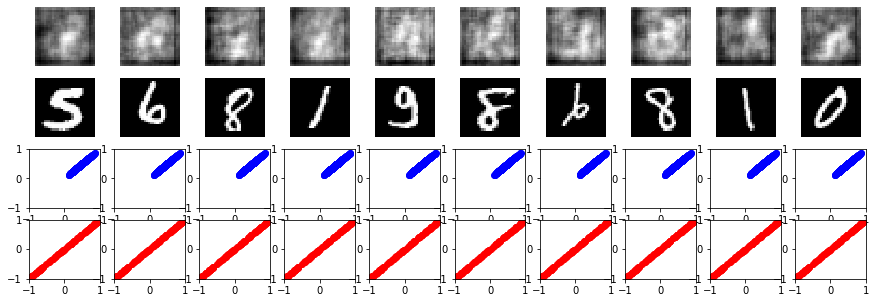

epoch:1  d_Loss:0.6256  g_loss:0.2620


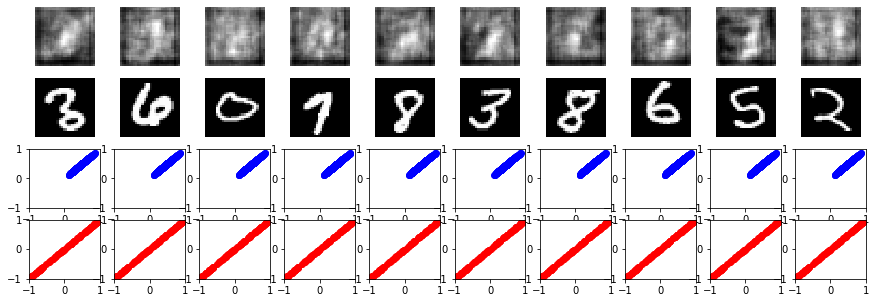

epoch:2  d_Loss:2.3926  g_loss:0.2213


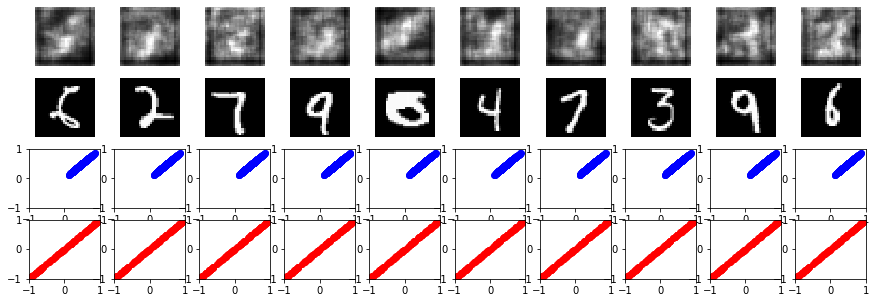

epoch:3  d_Loss:2.2019  g_loss:0.1204


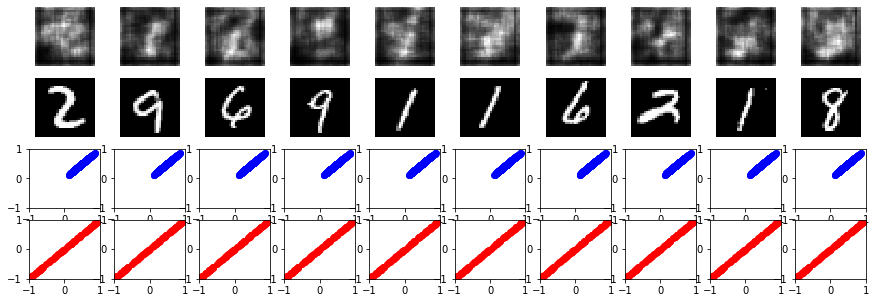

epoch:4  d_Loss:0.6849  g_loss:0.6829


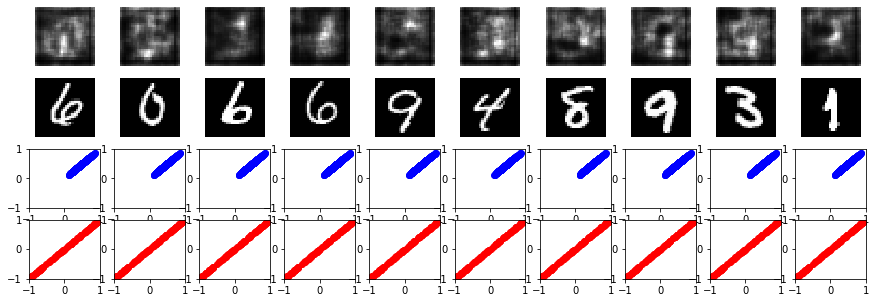

epoch:5  d_Loss:0.3161  g_loss:1.8212


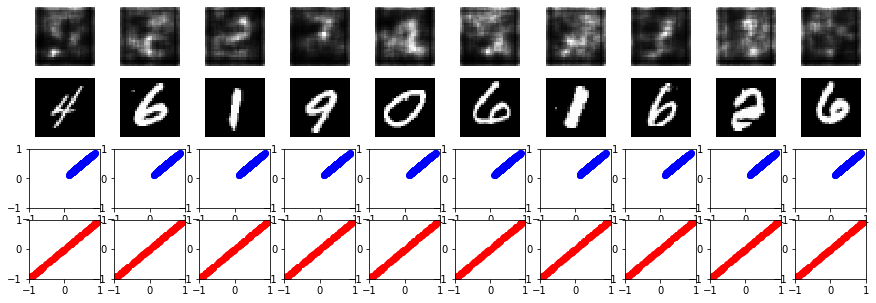

epoch:6  d_Loss:0.2360  g_loss:3.2115


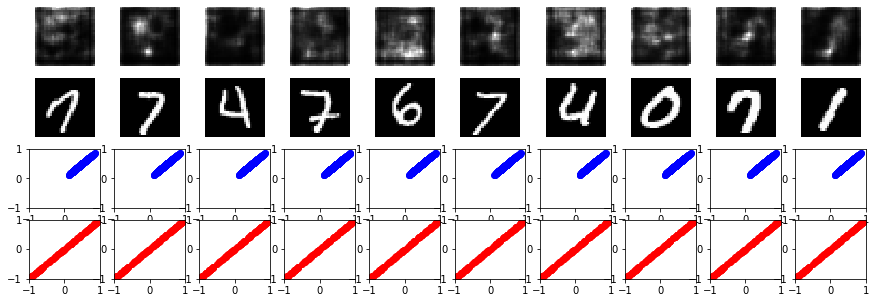

epoch:7  d_Loss:0.1681  g_loss:3.6109


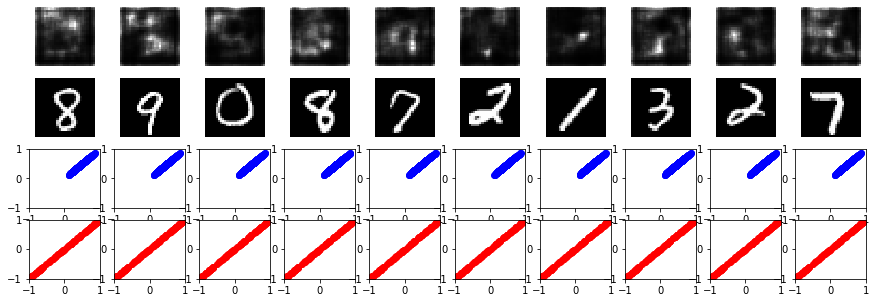

epoch:8  d_Loss:0.1728  g_loss:2.5645


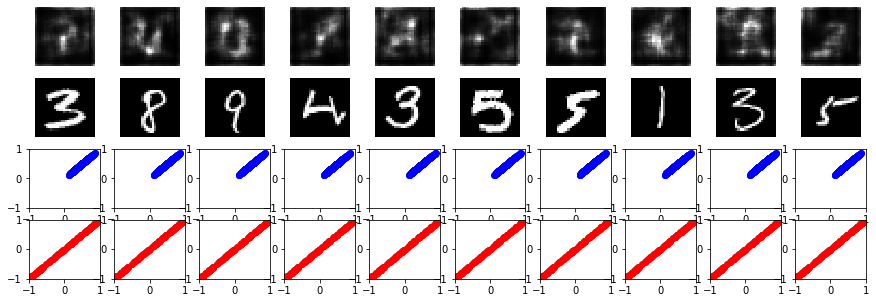

epoch:9  d_Loss:0.0509  g_loss:1.6299


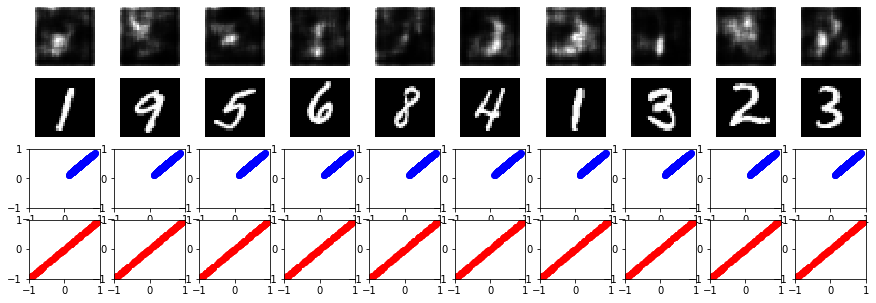

epoch:10  d_Loss:0.1096  g_loss:1.0132


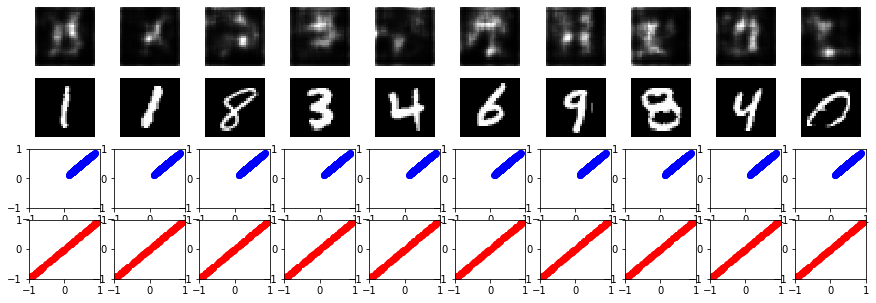

epoch:11  d_Loss:0.1667  g_loss:1.3249


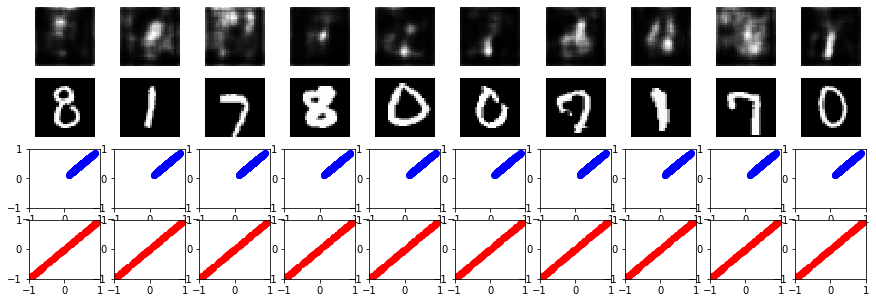

epoch:12  d_Loss:0.0853  g_loss:1.4513


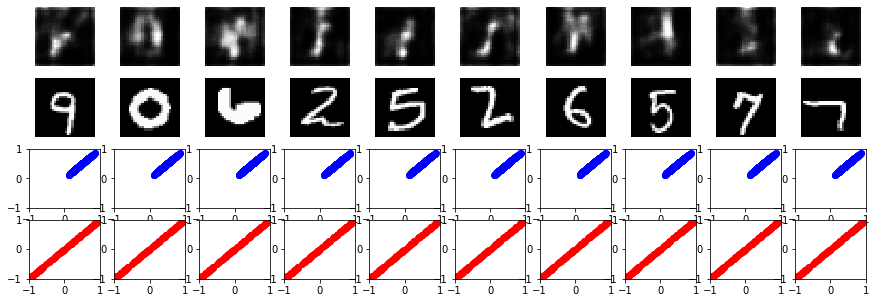

epoch:13  d_Loss:0.2605  g_loss:1.5854


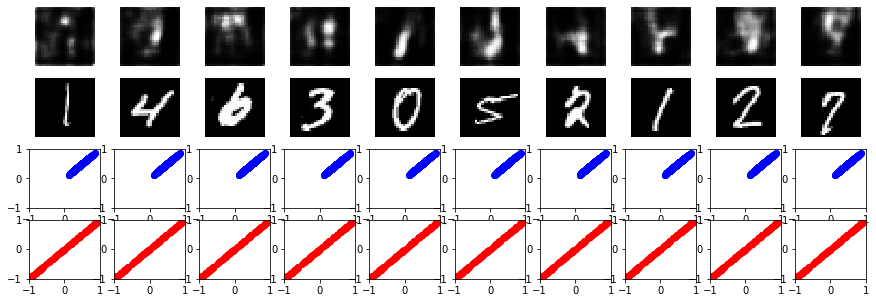

epoch:14  d_Loss:0.1377  g_loss:0.4700


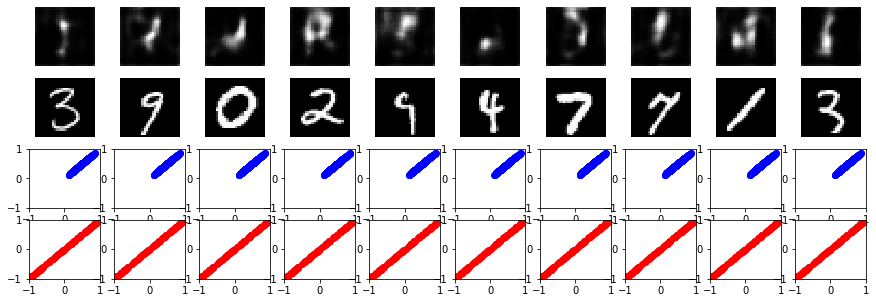

epoch:15  d_Loss:0.2227  g_loss:0.4272


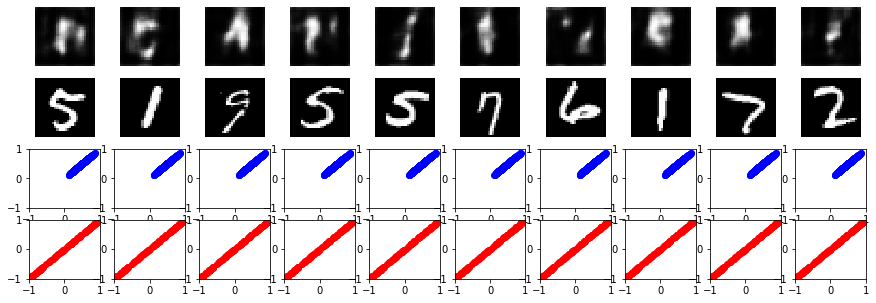

epoch:16  d_Loss:0.5402  g_loss:0.0128


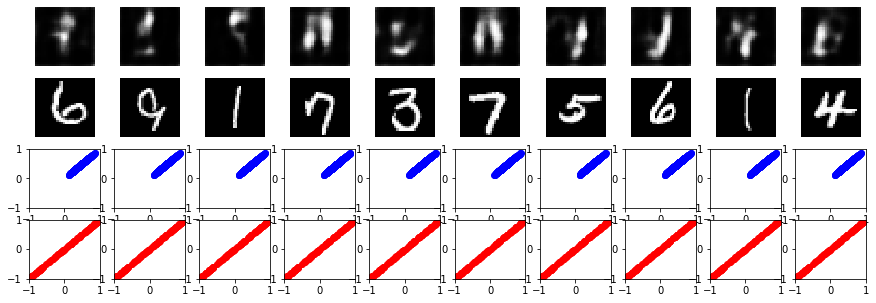

epoch:17  d_Loss:1.0009  g_loss:0.0154


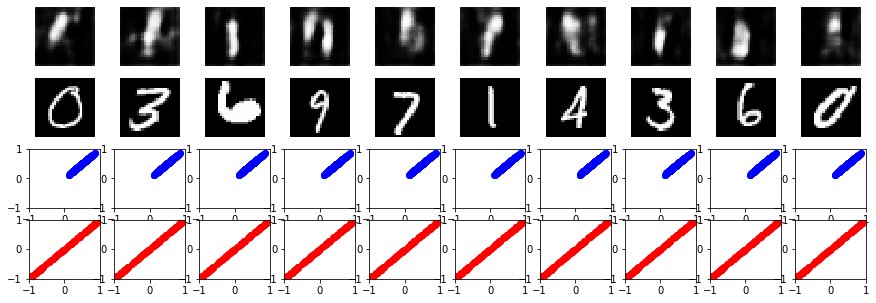

epoch:18  d_Loss:0.3260  g_loss:0.1977


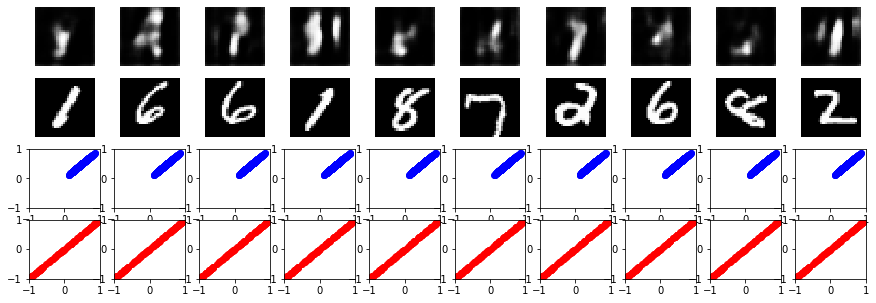

epoch:19  d_Loss:0.4167  g_loss:0.5091


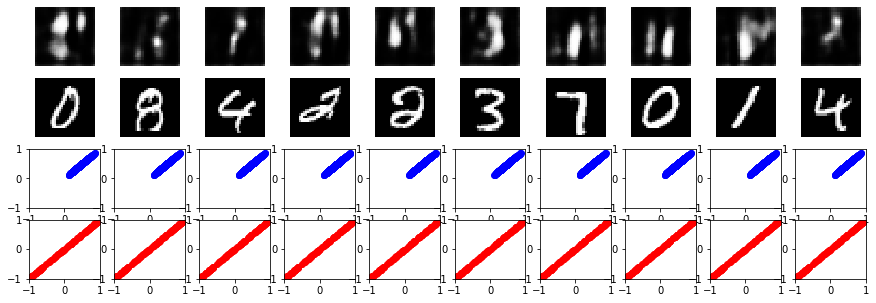

In [140]:
for i in range(epoch):
    idx = np.random.randint(0, X_train.shape[0], batch_size) # 0~ 60000 범위내에서 32개의 난수 생성
    imgs = X_train[idx] # X_train의 idx 32개를 저장
    d_loss_real = d_model.train_on_batch(imgs, true) # X_train의 32개는 모두 real 학습

    noise = np.random.normal(0, 1, (batch_size, 100)) # 0 ~ 1 범위내에서 (32, 100) 개의 난수 생성
    gen_imgs = g_model.predict(noise) # 생성자에 
    d_loss_fake = d_model.train_on_batch(gen_imgs, fake) 

    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    g_loss = gan.train_on_batch(noise, true) 

    # 기록
    record = (epoch, d_loss, g_loss)
    history.append(record)

    print('epoch:%d' %i, ' d_Loss:%.4f' % d_loss, ' g_loss:%.4f' % g_loss) 

    # gen_imgs = g_model.predict(noise)
    # gen_imgs = 0.5 * gen_imgs + 0.5

    fig, axs = plt.subplots(4, 10, figsize=(15, 5))
    count = 0

    for j in range(axs.shape[1]) :
        axs[0, j].axis('off')
        axs[0, j].imshow(gen_imgs[j].reshape((rows, cloums)), cmap='gray') 
        axs[1, j].axis('off')
        axs[1, j].imshow(imgs[j].reshape((rows, cloums)), cmap='gray')    
        #axs[2, j].axis('off')
        axs[2, j].set_ylim([-1, 1])
        axs[2, j].set_xlim([-1, 1]) 
        axs[2, j].scatter(gen_x, gen_y, color='b')
        #axs[3, j].axis('off')
        axs[3, j].set_ylim([-1, 1])
        axs[3, j].set_xlim([-1, 1])
        axs[3, j].scatter(real_x, real_y, color='r')    
    plt.show()
    plt.close(fig)

In [ ]:
# 한개씩 확인
plt.figure(figsize=(10,10))
plt.subplot(4, 2, 1)
plt.imshow(gen_imgs[0].reshape((rows, cloums)), cmap='gray')
plt.title('gen_image')

plt.subplot(4, 2 ,2)
plt.imshow(imgs[0].reshape((rows, cloums)), cmap='gray')
plt.title('real_image')

plt.subplot(4, 2, 3)
gen_x = gen_imgs[0]
gen_y = gen_imgs[0]
plt.scatter(gen_x, gen_y, color='b')
#plt.xlim(-1. , 1. )
#plt.ylim(-1. , 1. )

plt.subplot(4, 2, 4)
real_x = imgs[0]
real_y = imgs[0]
plt.scatter(real_x, real_y, color='r')
plt.xlim(-1. , 1. )
plt.ylim(-1. , 1. )

plt.show()
plt.close()

In [ ]:
plt.plot(d_loss_real.history['d_loss_real'])
#plt.plot(history.history['val_loss'])
plt.plot(d_loss_real.history['accuracy'])
#plt.plot(history.history['val_accuracy'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['loss', 'val_loss', 'accuracy', 'val_accuracy'], loc='upper right')
plt.show()

In [ ]:
for i in range(epoch) :
    idx = np.random.randint(0, X_train.shape[0], batch_size)
    imgs = X_train[idx]
    d_loss_real = d_model.train_on_batch(imgs, true)
    
    noise = np.random.normal(0, 1, (batch_size, 100))
    gen_imgs = g_model.predict(noise)
    d_loss_fake = d_model.train_on_batch(gen_imgs, fake) 

    d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
    g_loss = gan.train_on_batch(noise, true) 

    # 기록
    record = (epoch, d_loss, g_loss)
    history.append(record)
    
    print('epoch:%d' %i, ' d_Loss:%.4f' % d_loss, ' g_loss:%.4f' % g_loss) 

    
    if i % saving_interval == 0:
        #r, c = 5, 5
        noise = np.random.normal(0, 1, (25, 100))
        gen_imgs = g_model.predict(noise)
        print(gen_imgs.shape)
        # Rescale images 0 - 1
        gen_imgs = 0.5 * gen_imgs + 0.5

        fig, axs = plt.subplots(1, 10, figsize=(10, 1))
        count = 0
        for j in range(10):
            axs[j].title("M_{0}".format(j))
            axs[j].axis('off')
            axs[j].imshow(imgs[j].reshape((28, 28)), cmap='gray')
        fig.savefig("gan_images/gan_mnist_%d.png" % i)
        plt.show()
        plt.close(fig)

In [ ]:
model_dir = './Gan_model'
if not os.path.exists(model_dir):
    os.mkdir(model_dir)
g_model.save_weights('my_g_model.h5')

In [ ]:
from pandas import Series, DataFrame
import pandas as pd 

df = DataFrame(history, columns=['epoch', 'd_loss', 'g_loss'])

df.plot(y=['d_loss', 'g_loss'])
plt.legend(loc='upper right')
plt.grid()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show()

In [ ]:
model = Sequential()
model.add(Dense(256, (3, 3), input_shape=(imgs)  ,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(128, (3,3), activation='relu'))


In [ ]:
# def gan_train(epoch, batch_size, saving_interval) :
#     (X_train, _), (_,_) = mnist.load_data()
#     X_train = X_train.reshape(X_train.shape[0], 28, 28, 1).astype('float32')
#     X_train = (X_train -127.5) / 127.5
#     true = np.ones((batch_size, 1))
#     fake = np.zeros((batch_size, 1))
    
#     for i in range(epoch) :
#         idx = np.random.randint(0, X_train.shape[0], batch_size)
#         imgs = X_train[idx]
#         d_loss_real = d_model.train_on_batch(imgs, true)
        
#         noise = np.random.normal(0, 1, (batch_size, 100))
#         gen_imgs = g_model.predict(noise)
#         d_loss_fake = d_model.train_on_batch(gen_imgs, fake) 
        
#         d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
#         g_loss = gan.train_on_batch(noise, true) 
        
#         print('epoch:%d' %i, ' dLoss:%.4f' % d_loss, ' g_loss:%.4f' % g_loss) 
        
#         if i % saving_interval == 0:
#             #r, c = 5, 5
#             noise = np.random.normal(0, 1, (25, 100))
#             gen_imgs = g_model.predict(noise)

#             # Rescale images 0 - 1
#             gen_imgs = 0.5 * gen_imgs + 0.5

#             fig, axs = plt.subplots(5, 5)
#             count = 0
#             for j in range(5):
#               for k in range(5):
#                   axs[j, k].imshow(gen_imgs[count, :, :, 0], cmap='gray')
#                   axs[j, k].axis('off')
#                   count += 1
#             fig.savefig("gan_images/gan_mnist_%d.png" % i)